<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#0-Initiation" data-toc-modified-id="0-Initiation-1">0 Initiation</a></span></li><li><span><a href="#1-Balancing-KeyChoice-/-RespOri" data-toc-modified-id="1-Balancing-KeyChoice-/-RespOri-2">1 Balancing KeyChoice / RespOri</a></span><ul class="toc-item"><li><span><a href="#1.1-SD_Artifacts" data-toc-modified-id="1.1-SD_Artifacts-2.1">1.1 SD_Artifacts</a></span></li><li><span><a href="#1.2-Pure-Perceptual-SD-Effect" data-toc-modified-id="1.2-Pure-Perceptual-SD-Effect-2.2">1.2 Pure Perceptual SD Effect</a></span><ul class="toc-item"><li><span><a href="#1.2.1-Averaged-SD-and-Criterion" data-toc-modified-id="1.2.1-Averaged-SD-and-Criterion-2.2.1">1.2.1 Averaged SD and Criterion</a></span></li><li><span><a href="#1.2.2-Adding-Feedbacks" data-toc-modified-id="1.2.2-Adding-Feedbacks-2.2.2">1.2.2 Adding Feedbacks</a></span></li><li><span><a href="#1.2.3-Barplot" data-toc-modified-id="1.2.3-Barplot-2.2.3">1.2.3 Barplot</a></span></li></ul></li><li><span><a href="#1.3-Pure-Motor-Serial-Dependence" data-toc-modified-id="1.3-Pure-Motor-Serial-Dependence-2.3">1.3 Pure Motor Serial Dependence</a></span><ul class="toc-item"><li><span><a href="#1.3.1-Averaged-SD-and-Criterion" data-toc-modified-id="1.3.1-Averaged-SD-and-Criterion-2.3.1">1.3.1 Averaged SD and Criterion</a></span></li><li><span><a href="#1.3.2-Adding-Feedback" data-toc-modified-id="1.3.2-Adding-Feedback-2.3.2">1.3.2 Adding Feedback</a></span></li><li><span><a href="#1.3.3-Barplot" data-toc-modified-id="1.3.3-Barplot-2.3.3">1.3.3 Barplot</a></span></li></ul></li></ul></li><li><span><a href="#2-Combining-KeyChoice-/-RespOri" data-toc-modified-id="2-Combining-KeyChoice-/-RespOri-3">2 Combining KeyChoice / RespOri</a></span><ul class="toc-item"><li><span><a href="#2.1-SD-Artifacts" data-toc-modified-id="2.1-SD-Artifacts-3.1">2.1 SD Artifacts</a></span></li><li><span><a href="#2.2-Pure-Perceptual-Serial-Dependence" data-toc-modified-id="2.2-Pure-Perceptual-Serial-Dependence-3.2">2.2 Pure Perceptual Serial Dependence</a></span><ul class="toc-item"><li><span><a href="#2.2.1-Averaged-SD-and-Criterion" data-toc-modified-id="2.2.1-Averaged-SD-and-Criterion-3.2.1">2.2.1 Averaged SD and Criterion</a></span></li><li><span><a href="#2.2.2-Adding-Feedback" data-toc-modified-id="2.2.2-Adding-Feedback-3.2.2">2.2.2 Adding Feedback</a></span></li><li><span><a href="#2.2.3-BarPlot" data-toc-modified-id="2.2.3-BarPlot-3.2.3">2.2.3 BarPlot</a></span></li></ul></li><li><span><a href="#2.3-Pure-Motor-Serial-Dependence" data-toc-modified-id="2.3-Pure-Motor-Serial-Dependence-3.3">2.3 Pure Motor Serial Dependence</a></span><ul class="toc-item"><li><span><a href="#2.3.1-Averaged-SD-and-Criterion" data-toc-modified-id="2.3.1-Averaged-SD-and-Criterion-3.3.1">2.3.1 Averaged SD and Criterion</a></span></li><li><span><a href="#2.3.2-Adding-Feedback" data-toc-modified-id="2.3.2-Adding-Feedback-3.3.2">2.3.2 Adding Feedback</a></span></li><li><span><a href="#2.3.3-Barplot" data-toc-modified-id="2.3.3-Barplot-3.3.3">2.3.3 Barplot</a></span></li></ul></li></ul></li><li><span><a href="#3-Non-SDT-Percentage-Check" data-toc-modified-id="3-Non-SDT-Percentage-Check-4">3 Non-SDT Percentage Check</a></span></li><li><span><a href="#4-Confounder-Check-(Uncertainty)" data-toc-modified-id="4-Confounder-Check-(Uncertainty)-5">4 Confounder Check (Uncertainty)</a></span><ul class="toc-item"><li><span><a href="#4.1-Reaction-Times" data-toc-modified-id="4.1-Reaction-Times-5.1">4.1 Reaction Times</a></span></li><li><span><a href="#4.2-Stimulus-Contrast" data-toc-modified-id="4.2-Stimulus-Contrast-5.2">4.2 Stimulus Contrast</a></span></li></ul></li></ul></div>

# 0 Initiation

In [3]:
# Initiation 2023-12-04 20:29:04 

import arviz as az
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import constrNMPy
import os 
import warnings
import dill

from matplotlib import gridspec
from scipy import sparse, special, stats

%config InlineBackend.figure_format = 'retina'
warnings.simplefilter(action="ignore", category=FutureWarning)

os.chdir('//Users/abel/Desktop/SD_analysis/SD_ALiyun/SD_output')

# color pallette
[gr,ye,re,bl,pu,ir,ak] = ['#8ECFC9', '#FFBE7A', '#FA7F6F', '#82B0D2','#BEB8DC', '#E7DAD2','#999999']
[vio, grb, lig, sil, aqua] = ['#8c84cf','#6699CC','#66CC99','#C0C0C0','#6db3bc']
# set the style of the plots
az.style.use("arviz-white")

def apply_color(value):
    if value < 0.05:
        color = re
    elif value < 0.1:
        color = pu
    else:
        color = '#000000'
    return 'color: %s' % color

# Define criterion & d' function

from statistics import mean, stdev
from math import sqrt

# 1 Balancing KeyChoice / RespOri

## 1.1 SD_Artifacts

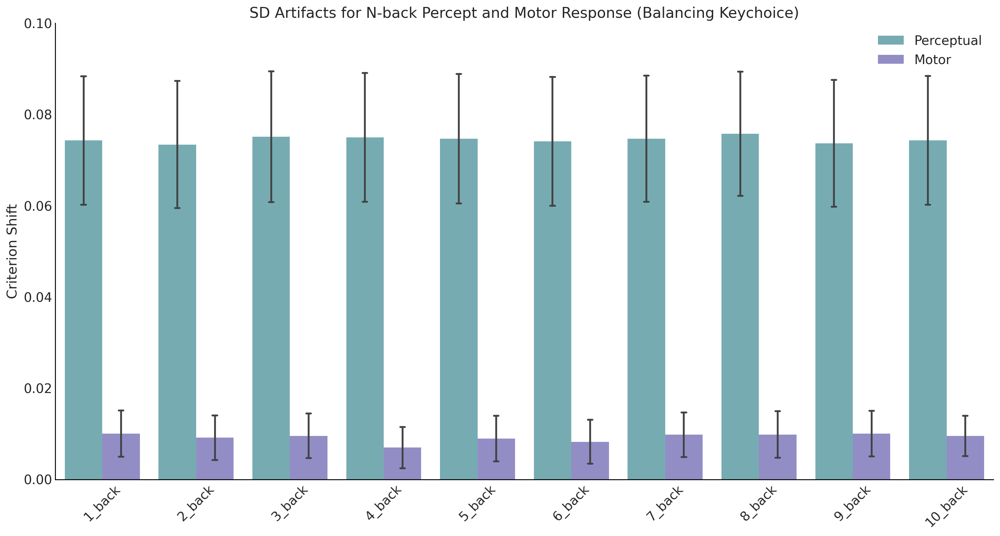

In [22]:
# Load the data
import dill

with open('SD_Perceptual_Artifacts.pkl', 'rb') as f:
    SD_Perceptual_Artifacts = -dill.load(f)  # obj = dill.load(file)

with open('SD_Motor_Artifacts.pkl', 'rb') as f:
    SD_Motor_Artifacts = -dill.load(f)  # obj = dill.load(file)

# Assuming the dataframes have similar structure and can be concatenated
# Creating two example dataframes with 23x10 dimension
df1 = SD_Perceptual_Artifacts.copy()
df2 = SD_Motor_Artifacts.copy()

# Adding an identifier column to distinguish between the two dataframes
df1['Group'] = 'Perceptual'
df2['Group'] = 'Motor'

# Concatenating the dataframes
df = pd.concat([df1, df2])

# Melting the dataframe to a long format suitable for seaborn's barplot
df_long = df.melt(id_vars='Group', var_name='Column', value_name='Value')
SD_Artifacts_data = df_long

# Plotting the grouped bar chart
plt.figure(figsize=(15, 8))
sns.barplot(x='Column',
            y='Value',
            hue='Group',
            data=df_long,
            palette=[aqua, vio],
            errorbar='se',
            errwidth=2,
            capsize=0.05)
plt.xticks(rotation=45)
plt.ylim(0, 0.1)
plt.legend(loc='upper right')
plt.title(
    'SD Artifacts for N-back Percept and Motor Response (Balancing Keychoice)')
plt.ylabel('Criterion Shift')
plt.xlabel('')
plt.show()

In [25]:
df_long_pivot = df_long.copy()
df_long_pivot['Subject'] = np.tile(np.arange(1, 33), 20)
df_long_pivot = df_long_pivot.pivot(index='Subject', columns=['Column', 'Group'])
df_long_pivot.columns = df_long_pivot.columns.droplevel(0)
df_long_pivot.columns = df_long_pivot.columns.map('{0[0]}_{0[1]}'.format)
df_long_pivot.to_csv('/Users/abel/Desktop/SD_analysis/SD_ALiyun/SD_output/csv/SD_Artifacts.csv')

## 1.2 Pure Perceptual SD Effect

### 1.2.1 Averaged SD and Criterion

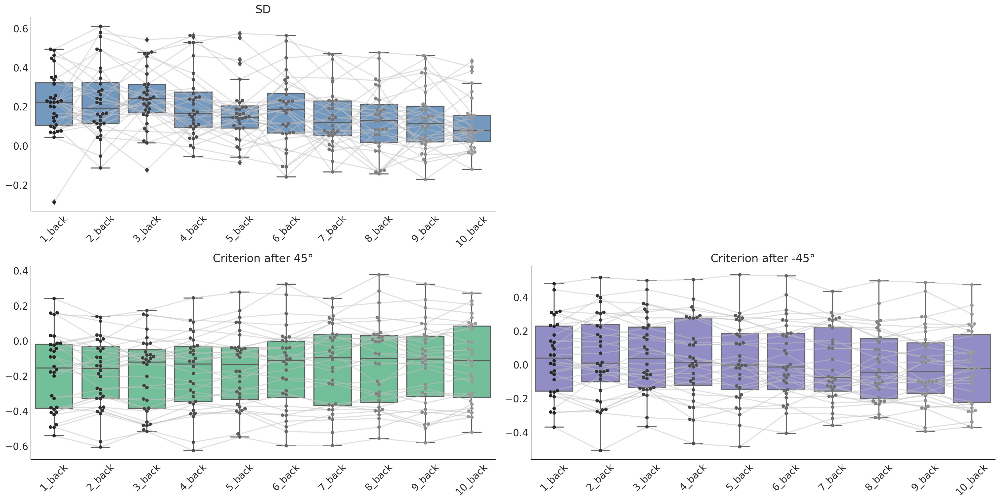

In [5]:
# Load data
with open('./SD_Perceptual_balance_keys_averaged.pkl', 'rb') as f:
    [SD_Percept, Criterion_Percept_45,
     Criterion_Percept_n45] = dill.load(f)  # obj = dill.load(file)

SD_Percept_pure = SD_Percept - SD_Perceptual_Artifacts

plt.figure(figsize=(20, 10))
plt.subplot(2, 2, 1)
plt.title('SD')
sns.boxplot(data=SD_Percept, color=grb)
sns.swarmplot(data=SD_Percept, color=ak)
for i in range(32):
    plt.plot(np.arange(0, 10), SD_Percept.iloc[i, :], color=sil, alpha=0.5)
plt.xticks(rotation=45)
plt.subplot(2, 2, 3)
plt.title('Criterion after 45°')
sns.boxplot(data=Criterion_Percept_45, color=lig)
sns.swarmplot(data=Criterion_Percept_45, color=ak)
for i in range(32):
    plt.plot(np.arange(0, 10),
             Criterion_Percept_45.iloc[i, :],
             color=sil,
             alpha=0.5)
plt.xticks(rotation=45)
plt.subplot(2, 2, 4)
plt.title('Criterion after -45°')
sns.boxplot(data=Criterion_Percept_n45, color=vio)
sns.swarmplot(data=Criterion_Percept_n45, color=ak)
for i in range(32):
    plt.plot(np.arange(0, 10),
             Criterion_Percept_n45.iloc[i, :],
             color=sil,
             alpha=0.5)
plt.xticks(rotation=45)
plt.show()

### 1.2.2 Adding Feedbacks 

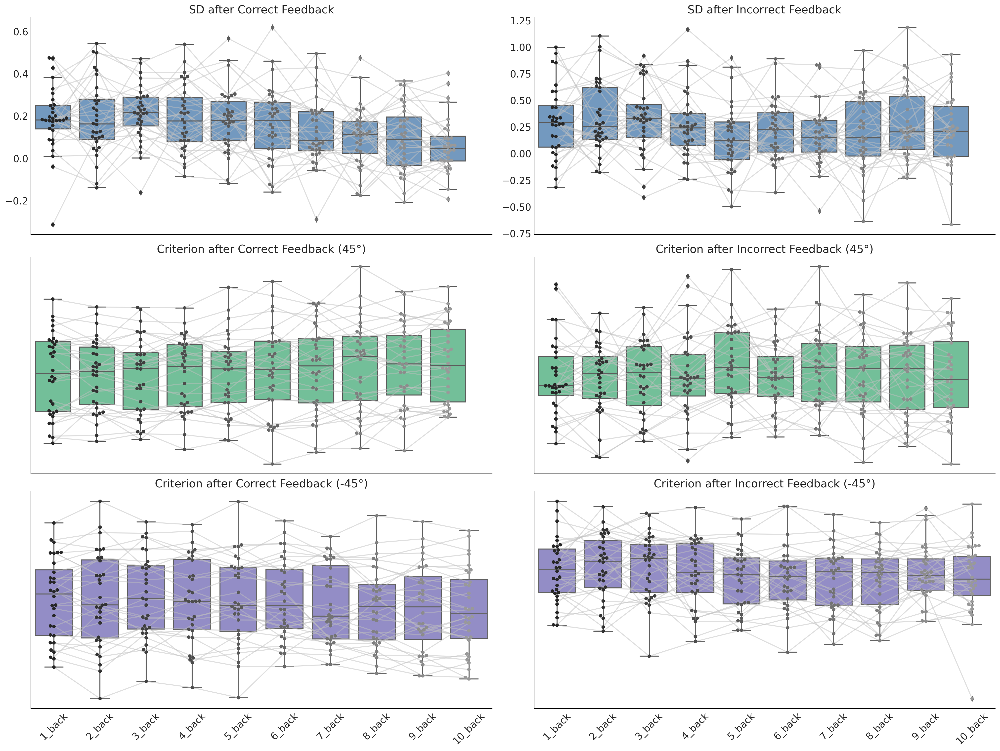

In [6]:
# load data
with open('./SD_Perceptual_balance_keys_FB.pkl', 'rb') as f:
    [
        SD_Percept_Y, Criterion_Percept_Y_45, Criterion_Percept_Y_n45,
        SD_Percept_N, Criterion_Percept_N_45, Criterion_Percept_N_n45
    ] = dill.load(f)

SD_Percept_Y_pure = SD_Percept_Y - SD_Perceptual_Artifacts
SD_Percept_N_pure = SD_Percept_N - SD_Perceptual_Artifacts

fig, axes = plt.subplots(3, 2, figsize=(20, 15), dpi=100)

axes[0, 0].set_title('SD after Correct Feedback')
sns.boxplot(data=SD_Percept_Y, color=grb, ax=axes[0, 0])
sns.swarmplot(data=SD_Percept_Y, color=ak, ax=axes[0, 0])
for i in range(32):
    axes[0, 0].plot(np.arange(0, 10),
                    SD_Percept_Y.iloc[i, :],
                    color=sil,
                    alpha=0.5)
axes[0, 0].set_xticks('')
axes[0, 0].set_xticklabels('')
axes[0, 0].set_xlabel('')

axes[0, 1].set_title('SD after Incorrect Feedback')
sns.boxplot(data=SD_Percept_N, color=grb, ax=axes[0, 1])
sns.swarmplot(data=SD_Percept_N, color=ak, ax=axes[0, 1])
for i in range(32):
    axes[0, 1].plot(np.arange(0, 10),
                    SD_Percept_N.iloc[i, :],
                    color=sil,
                    alpha=0.5)
axes[0, 1].set_xticks('')
axes[0, 1].set_xticklabels('')
axes[0, 1].set_xlabel('')

axes[1, 0].set_title('Criterion after Correct Feedback (45°)')
sns.boxplot(data=Criterion_Percept_Y_45, color=lig, ax=axes[1, 0])
sns.swarmplot(data=Criterion_Percept_Y_45, color=ak, ax=axes[1, 0])
for i in range(32):
    axes[1, 0].plot(np.arange(0, 10),
                    Criterion_Percept_Y_45.iloc[i, :],
                    color=sil,
                    alpha=0.5)
axes[1, 0].set_xticks('')
axes[1, 0].set_xticklabels('')
axes[1, 0].set_xlabel('')
axes[1, 0].set_ylabel('')
axes[1, 0].set_yticklabels('')

axes[1, 1].set_title('Criterion after Incorrect Feedback (45°)')
sns.boxplot(data=Criterion_Percept_N_45, color=lig, ax=axes[1, 1])
sns.swarmplot(data=Criterion_Percept_N_45, color=ak, ax=axes[1, 1])
for i in range(32):
    axes[1, 1].plot(np.arange(0, 10),
                    Criterion_Percept_N_45.iloc[i, :],
                    color=sil,
                    alpha=0.5)
axes[1, 1].set_xticks('')
axes[1, 1].set_xticklabels('')
axes[1, 1].set_xlabel('')
axes[1, 1].set_ylabel('')
axes[1, 1].set_yticklabels('')

axes[2, 0].set_title('Criterion after Correct Feedback (-45°)')
sns.boxplot(data=Criterion_Percept_Y_n45, color=vio, ax=axes[2, 0])
sns.swarmplot(data=Criterion_Percept_Y_n45, color=ak, ax=axes[2, 0])
for i in range(32):
    axes[2, 0].plot(np.arange(0, 10),
                    Criterion_Percept_Y_n45.iloc[i, :],
                    color=sil,
                    alpha=0.5)
axes[2, 0].set_xticklabels(labels=[
    '1_back', '2_back', '3_back', '4_back', '5_back', '6_back', '7_back',
    '8_back', '9_back', '10_back'
],
                           rotation=45)
axes[2, 0].set_yticklabels('')

axes[2, 1].set_title('Criterion after Incorrect Feedback (-45°)')
sns.boxplot(data=Criterion_Percept_N_n45, color=vio, ax=axes[2, 1])
sns.swarmplot(data=Criterion_Percept_N_n45, color=ak, ax=axes[2, 1])
for i in range(32):
    axes[2, 1].plot(np.arange(0, 10),
                    Criterion_Percept_N_n45.iloc[i, :],
                    color=sil,
                    alpha=0.5)
plt.xticks(rotation=45)
axes[2, 1].set_yticklabels('')

plt.show()

### 1.2.3 Barplot 

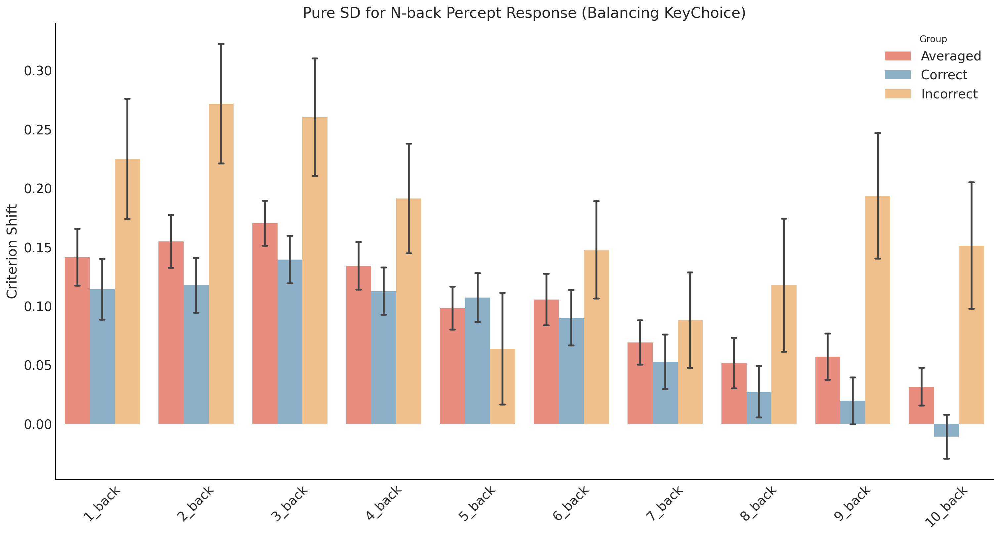

In [7]:
# Assuming the dataframes have similar structure and can be concatenated
# Creating two example dataframes with 23x10 dimension
df1 = SD_Percept_pure
df2 = SD_Percept_Y_pure
df3 = SD_Percept_N_pure

# Adding an identifier column to distinguish between the two dataframes
df1['Group'] = 'Averaged'
df2['Group'] = 'Correct'
df3['Group'] = 'Incorrect'

# Concatenating the dataframes
df = pd.concat([df1, df2, df3])

# Melting the dataframe to a long format suitable for seaborn's barplot
df_long = df.melt(id_vars='Group', var_name='Column', value_name='Value')
SD_Percept_data = df_long

# Plotting the grouped bar chart
plt.figure(figsize=(15, 8))
sns.barplot(x='Column',
            y='Value',
            hue='Group',
            data=df_long,
            palette=[re, bl, ye],
            errorbar='se',
            errwidth=2,
            capsize=0.05)
plt.xticks(rotation=45)
plt.title('Pure SD for N-back Percept Response (Balancing KeyChoice)')
plt.ylabel('Criterion Shift')
plt.xlabel('')
plt.show()

In [21]:
df_long_pivot = df_long.copy()
df_long_pivot['Subject'] = np.tile(np.arange(1, 33), 30)
df_long_pivot = df_long_pivot.pivot(index='Subject', columns=['Column', 'Group'])
df_long_pivot.columns = df_long_pivot.columns.droplevel(0)
df_long_pivot.columns = df_long_pivot.columns.map('{0[0]}_{0[1]}'.format)
df_long_pivot.to_csv('/Users/abel/Desktop/SD_analysis/SD_ALiyun/SD_output/csv/SD_Percept_data.csv')

## 1.3 Pure Motor Serial Dependence

### 1.3.1 Averaged SD and Criterion 

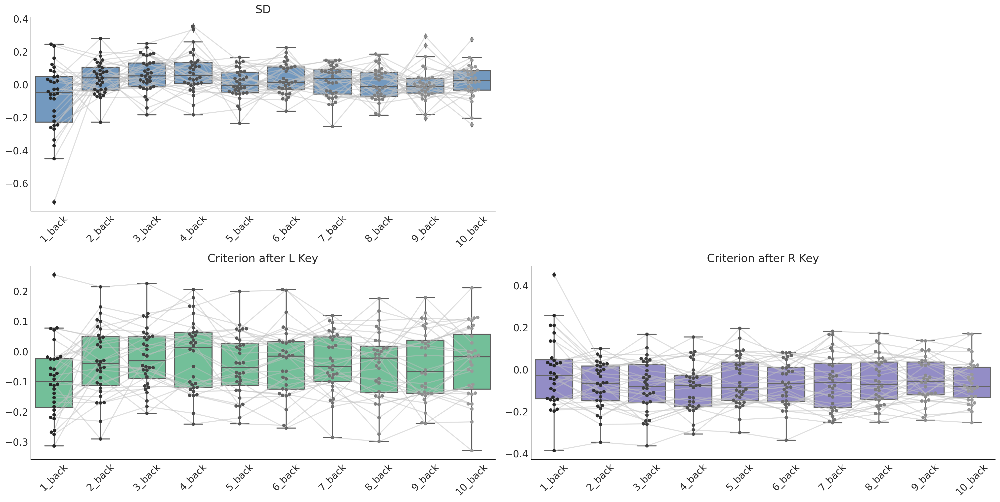

In [26]:
# Load data
with open('./SD_Motor_balance_keys_averaged.pkl', 'rb') as f:
    [SD_Motor, Criterion_Motor_L,
     Criterion_Motor_R] = dill.load(f)  # obj = dill.load(file)

SD_Motor_pure = SD_Motor - SD_Motor_Artifacts

dt1 = SD_Motor
dt2 = Criterion_Motor_L
dt3 = Criterion_Motor_R

plt.figure(figsize=(20, 10))
plt.subplot(2, 2, 1)
plt.title('SD')
sns.boxplot(data=dt1, color=grb)
sns.swarmplot(data=dt1, color=ak)
for i in range(32):
    plt.plot(np.arange(0, 10), dt1.iloc[i, :], color=sil, alpha=0.5)
plt.xticks(rotation=45)
plt.subplot(2, 2, 3)
plt.title('Criterion after L Key')
sns.boxplot(data=dt2, color=lig)
sns.swarmplot(data=dt2, color=ak)
for i in range(32):
    plt.plot(np.arange(0, 10), dt2.iloc[i, :], color=sil, alpha=0.5)
plt.xticks(rotation=45)
plt.subplot(2, 2, 4)
plt.title('Criterion after R Key')
sns.boxplot(data=dt3, color=vio)
sns.swarmplot(data=dt3, color=ak)
for i in range(32):
    plt.plot(np.arange(0, 10), dt3.iloc[i, :], color=sil, alpha=0.5)
plt.xticks(rotation=45)
plt.show()


### 1.3.2 Adding Feedback

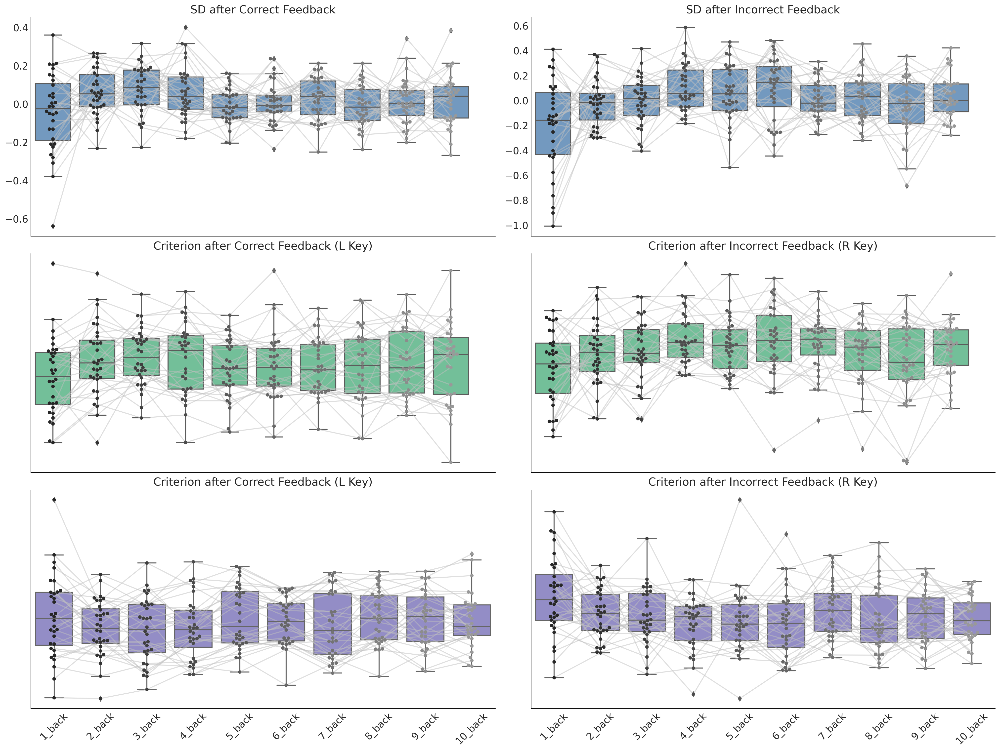

In [27]:
# load data
with open('./SD_Motor_balance_keys_FB.pkl', 'rb') as f:
    [
        SD_Motor_Y, Criterion_Motor_Y_L, Criterion_Motor_Y_R,
        SD_Motor_N, Criterion_Motor_N_L, Criterion_Motor_N_R
    ] = dill.load(f)

SD_Motor_Y_pure = SD_Motor_Y - SD_Motor_Artifacts
SD_Motor_N_pure = SD_Motor_N - SD_Motor_Artifacts

df1 = SD_Motor_Y
df2 = SD_Motor_N
df3 = Criterion_Motor_Y_L
df4 = Criterion_Motor_Y_R
df5 = Criterion_Motor_N_L
df6 = Criterion_Motor_N_R

fig, axes = plt.subplots(3, 2, figsize=(20, 15), dpi=100)

axes[0, 0].set_title('SD after Correct Feedback')
sns.boxplot(data=df1, color=grb, ax=axes[0, 0])
sns.swarmplot(data=df1, color=ak, ax=axes[0, 0])
for i in range(32):
    axes[0, 0].plot(np.arange(0, 10),
                    df1.iloc[i, :],
                    color=sil,
                    alpha=0.5)
axes[0, 0].set_xticks('')
axes[0, 0].set_xticklabels('')
axes[0, 0].set_xlabel('')

axes[0, 1].set_title('SD after Incorrect Feedback')
sns.boxplot(data=df2, color=grb, ax=axes[0, 1])
sns.swarmplot(data=df2, color=ak, ax=axes[0, 1])
for i in range(32):
    axes[0, 1].plot(np.arange(0, 10),
                    df2.iloc[i, :],
                    color=sil,
                    alpha=0.5)
axes[0, 1].set_xticks('')
axes[0, 1].set_xticklabels('')
axes[0, 1].set_xlabel('')

axes[1, 0].set_title('Criterion after Correct Feedback (L Key)')
sns.boxplot(data=df3, color=lig, ax=axes[1, 0])
sns.swarmplot(data=df3, color=ak, ax=axes[1, 0])
for i in range(32):
    axes[1, 0].plot(np.arange(0, 10),
                    df3.iloc[i, :],
                    color=sil,
                    alpha=0.5)
axes[1, 0].set_xticks('')
axes[1, 0].set_xticklabels('')
axes[1, 0].set_xlabel('')
axes[1, 0].set_ylabel('')
axes[1, 0].set_yticklabels('')

axes[1, 1].set_title('Criterion after Incorrect Feedback (R Key)')
sns.boxplot(data=df5, color=lig, ax=axes[1, 1])
sns.swarmplot(data=df5, color=ak, ax=axes[1, 1])
for i in range(32):
    axes[1, 1].plot(np.arange(0, 10),
                    df5.iloc[i, :],
                    color=sil,
                    alpha=0.5)
axes[1, 1].set_xticks('')
axes[1, 1].set_xticklabels('')
axes[1, 1].set_xlabel('')
axes[1, 1].set_ylabel('')
axes[1, 1].set_yticklabels('')

axes[2, 0].set_title('Criterion after Correct Feedback (L Key)')
sns.boxplot(data=df4, color=vio, ax=axes[2, 0])
sns.swarmplot(data=df4, color=ak, ax=axes[2, 0])
for i in range(32):
    axes[2, 0].plot(np.arange(0, 10),
                    df4.iloc[i, :],
                    color=sil,
                    alpha=0.5)
axes[2, 0].set_xticklabels(labels=[
    '1_back', '2_back', '3_back', '4_back', '5_back', '6_back', '7_back',
    '8_back', '9_back', '10_back'
],
                           rotation=45)
axes[2, 0].set_yticklabels('')

axes[2, 1].set_title('Criterion after Incorrect Feedback (R Key)')
sns.boxplot(data=df6, color=vio, ax=axes[2, 1])
sns.swarmplot(data=df6, color=ak, ax=axes[2, 1])
for i in range(32):
    axes[2, 1].plot(np.arange(0, 10),
                    df6.iloc[i, :],
                    color=sil,
                    alpha=0.5)
plt.xticks(rotation=45)
axes[2, 1].set_yticklabels('')

plt.show()

### 1.3.3 Barplot

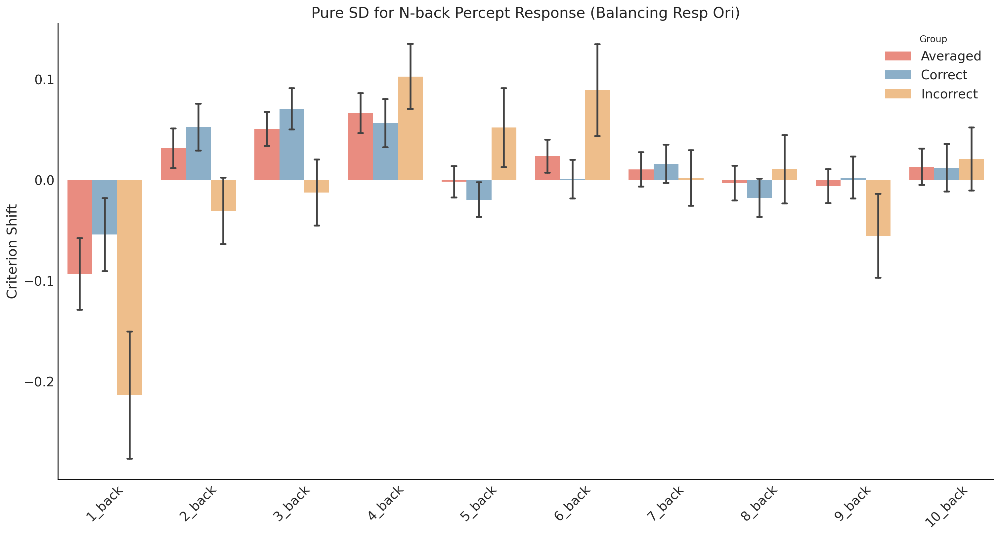

In [28]:
# Assuming the dataframes have similar structure and can be concatenated
# Creating two example dataframes with 23x10 dimension
df1 = SD_Motor_pure
df2 = SD_Motor_Y_pure
df3 = SD_Motor_N_pure

# Adding an identifier column to distinguish between the two dataframes
df1['Group'] = 'Averaged'
df2['Group'] = 'Correct'
df3['Group'] = 'Incorrect'

# Concatenating the dataframes
df = pd.concat([df1, df2, df3])

# Melting the dataframe to a long format suitable for seaborn's barplot
df_long = df.melt(id_vars='Group', var_name='Column', value_name='Value')
SD_Percept_data = df_long

# Plotting the grouped bar chart
plt.figure(figsize=(15, 8))
sns.barplot(x='Column',
            y='Value',
            hue='Group',
            data=df_long,
            palette=[re, bl, ye],
            errorbar='se',
            errwidth=2,
            capsize=0.05)
plt.xticks(rotation=45)
plt.title('Pure SD for N-back Percept Response (Balancing Resp Ori)')
plt.ylabel('Criterion Shift')
plt.xlabel('')
plt.show()

In [29]:
df_long_pivot = df_long.copy()
df_long_pivot['Subject'] = np.tile(np.arange(1, 33), 30)
df_long_pivot = df_long_pivot.pivot(index='Subject', columns=['Column', 'Group'])
df_long_pivot.columns = df_long_pivot.columns.droplevel(0)
df_long_pivot.columns = df_long_pivot.columns.map('{0[0]}_{0[1]}'.format)
df_long_pivot.to_csv('/Users/abel/Desktop/SD_analysis/SD_ALiyun/SD_output/csv/SD_Motor_data.csv')

# 2 Combining KeyChoice / RespOri

## 2.1 SD Artifacts

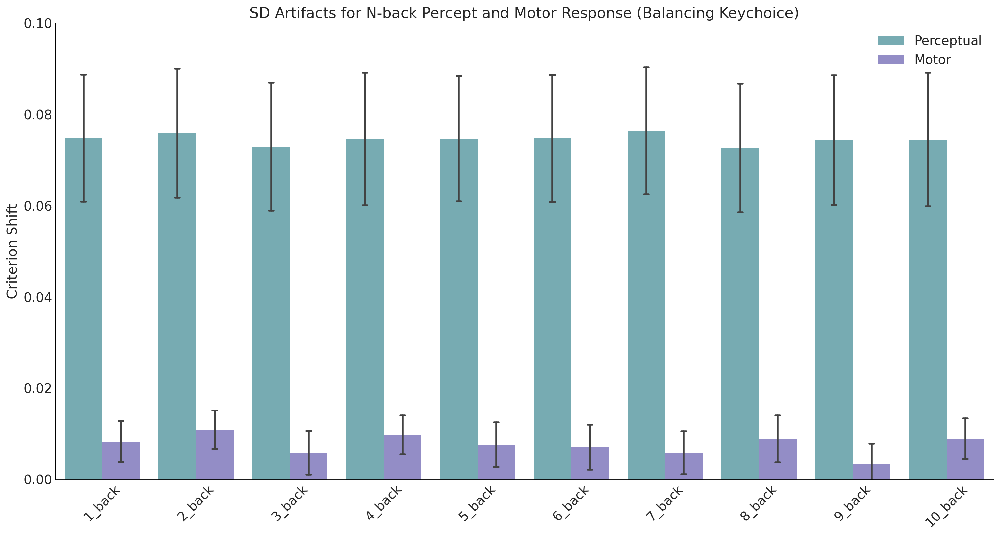

In [30]:
# Load the data
import dill

with open('SD_Perceptual_Artifacts_cb.pkl', 'rb') as f:
    SD_Perceptual_Artifacts_cb = dill.load(f)  # obj = dill.load(file)

with open('SD_Motor_Artifacts_cb.pkl', 'rb') as f:
    SD_Motor_Artifacts_cb = dill.load(f)  # obj = dill.load(file)

# Assuming the dataframes have similar structure and can be concatenated
# Creating two example dataframes with 23x10 dimension
df1 = SD_Perceptual_Artifacts_cb.copy()
df2 = SD_Motor_Artifacts_cb.copy()

# Adding an identifier column to distinguish between the two dataframes
df1['Group'] = 'Perceptual'
df2['Group'] = 'Motor'

# Concatenating the dataframes
df = pd.concat([df1, df2])

# Melting the dataframe to a long format suitable for seaborn's barplot
df_long = df.melt(id_vars='Group', var_name='Column', value_name='Value')
SD_Artifacts_data = df_long

# Plotting the grouped bar chart
plt.figure(figsize=(15, 8))
sns.barplot(x='Column',
            y='Value',
            hue='Group',
            data=df_long,
            palette=[aqua, vio],
            errorbar='se',
            errwidth=2,
            capsize=0.05)
plt.xticks(rotation=45)
plt.ylim(0, 0.1)
plt.legend(loc='upper right')
plt.title(
    'SD Artifacts for N-back Percept and Motor Response (Balancing Keychoice)')
plt.ylabel('Criterion Shift')
plt.xlabel('')
plt.show()

In [31]:
df_long_pivot = df_long.copy()
df_long_pivot['Subject'] = np.tile(np.arange(1, 33), 20)
df_long_pivot = df_long_pivot.pivot(index='Subject', columns=['Column', 'Group'])
df_long_pivot.columns = df_long_pivot.columns.droplevel(0)
df_long_pivot.columns = df_long_pivot.columns.map('{0[0]}_{0[1]}'.format)
df_long_pivot.to_csv('/Users/abel/Desktop/SD_analysis/SD_ALiyun/SD_output/csv/SD_Artifacts_cb.csv')

## 2.2 Pure Perceptual Serial Dependence

### 2.2.1 Averaged SD and Criterion

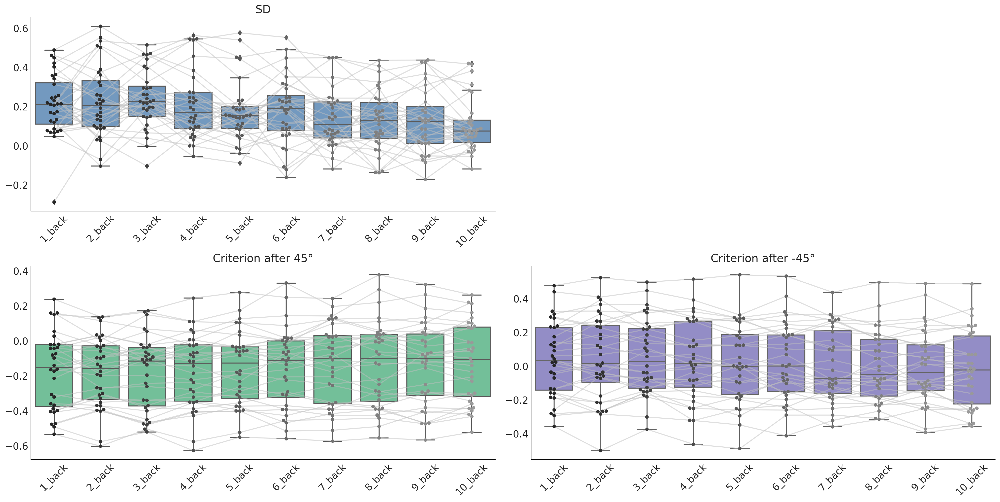

In [32]:
# Load data
with open('./SD_Perceptual_combined_averaged.pkl', 'rb') as f:
    [SD_Percept_cb, Criterion_Percept_45_cb,
     Criterion_Percept_n45_cb] = dill.load(f)  # obj = dill.load(file)

SD_Percept_pure_cb = SD_Percept_cb - SD_Perceptual_Artifacts_cb

plt.figure(figsize=(20, 10))
plt.subplot(2, 2, 1)
plt.title('SD')
sns.boxplot(data=SD_Percept_cb, color=grb)
sns.swarmplot(data=SD_Percept_cb, color=ak)
for i in range(32):
    plt.plot(np.arange(0, 10), SD_Percept_cb.iloc[i, :], color=sil, alpha=0.5)
plt.xticks(rotation=45)
plt.subplot(2, 2, 3)
plt.title('Criterion after 45°')
sns.boxplot(data=Criterion_Percept_45_cb, color=lig)
sns.swarmplot(data=Criterion_Percept_45_cb, color=ak)
for i in range(32):
    plt.plot(np.arange(0, 10),
             Criterion_Percept_45_cb.iloc[i, :],
             color=sil,
             alpha=0.5)
plt.xticks(rotation=45)
plt.subplot(2, 2, 4)
plt.title('Criterion after -45°')
sns.boxplot(data=Criterion_Percept_n45_cb, color=vio)
sns.swarmplot(data=Criterion_Percept_n45_cb, color=ak)
for i in range(32):
    plt.plot(np.arange(0, 10),
             Criterion_Percept_n45_cb.iloc[i, :],
             color=sil,
             alpha=0.5)
plt.xticks(rotation=45)
plt.show()

### 2.2.2 Adding Feedback 

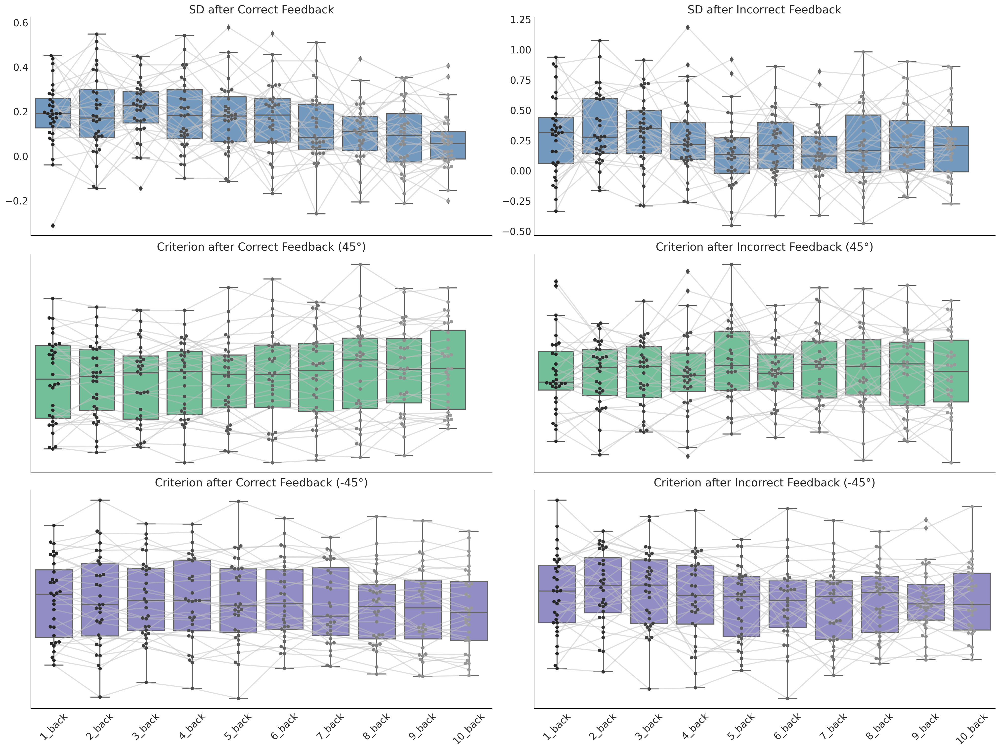

In [33]:
# load data
with open('./SD_Perceptual_combined_FB.pkl', 'rb') as f:
    [
        SD_Percept_Y_cb, Criterion_Percept_Y_45_cb, Criterion_Percept_Y_n45_cb,
        SD_Percept_N_cb, Criterion_Percept_N_45_cb, Criterion_Percept_N_n45_cb
    ] = dill.load(f)

SD_Percept_Y_pure_cb = SD_Percept_Y_cb - SD_Perceptual_Artifacts_cb
SD_Percept_N_pure_cb = SD_Percept_N_cb - SD_Perceptual_Artifacts_cb

fig, axes = plt.subplots(3, 2, figsize=(20, 15), dpi=100)

axes[0, 0].set_title('SD after Correct Feedback')
sns.boxplot(data=SD_Percept_Y_cb, color=grb, ax=axes[0, 0])
sns.swarmplot(data=SD_Percept_Y_cb, color=ak, ax=axes[0, 0])
for i in range(32):
    axes[0, 0].plot(np.arange(0, 10),
                    SD_Percept_Y_cb.iloc[i, :],
                    color=sil,
                    alpha=0.5)
axes[0, 0].set_xticks('')
axes[0, 0].set_xticklabels('')
axes[0, 0].set_xlabel('')

axes[0, 1].set_title('SD after Incorrect Feedback')
sns.boxplot(data=SD_Percept_N_cb, color=grb, ax=axes[0, 1])
sns.swarmplot(data=SD_Percept_N_cb, color=ak, ax=axes[0, 1])
for i in range(32):
    axes[0, 1].plot(np.arange(0, 10),
                    SD_Percept_N_cb.iloc[i, :],
                    color=sil,
                    alpha=0.5)
axes[0, 1].set_xticks('')
axes[0, 1].set_xticklabels('')
axes[0, 1].set_xlabel('')

axes[1, 0].set_title('Criterion after Correct Feedback (45°)')
sns.boxplot(data=Criterion_Percept_Y_45_cb, color=lig, ax=axes[1, 0])
sns.swarmplot(data=Criterion_Percept_Y_45_cb, color=ak, ax=axes[1, 0])
for i in range(32):
    axes[1, 0].plot(np.arange(0, 10),
                    Criterion_Percept_Y_45_cb.iloc[i, :],
                    color=sil,
                    alpha=0.5)
axes[1, 0].set_xticks('')
axes[1, 0].set_xticklabels('')
axes[1, 0].set_xlabel('')
axes[1, 0].set_ylabel('')
axes[1, 0].set_yticklabels('')

axes[1, 1].set_title('Criterion after Incorrect Feedback (45°)')
sns.boxplot(data=Criterion_Percept_N_45_cb, color=lig, ax=axes[1, 1])
sns.swarmplot(data=Criterion_Percept_N_45_cb, color=ak, ax=axes[1, 1])
for i in range(32):
    axes[1, 1].plot(np.arange(0, 10),
                    Criterion_Percept_N_45_cb.iloc[i, :],
                    color=sil,
                    alpha=0.5)
axes[1, 1].set_xticks('')
axes[1, 1].set_xticklabels('')
axes[1, 1].set_xlabel('')
axes[1, 1].set_ylabel('')
axes[1, 1].set_yticklabels('')

axes[2, 0].set_title('Criterion after Correct Feedback (-45°)')
sns.boxplot(data=Criterion_Percept_Y_n45_cb, color=vio, ax=axes[2, 0])
sns.swarmplot(data=Criterion_Percept_Y_n45_cb, color=ak, ax=axes[2, 0])
for i in range(32):
    axes[2, 0].plot(np.arange(0, 10),
                    Criterion_Percept_Y_n45_cb.iloc[i, :],
                    color=sil,
                    alpha=0.5)
axes[2, 0].set_xticklabels(labels=[
    '1_back', '2_back', '3_back', '4_back', '5_back', '6_back', '7_back',
    '8_back', '9_back', '10_back'
],
                           rotation=45)
axes[2, 0].set_yticklabels('')

axes[2, 1].set_title('Criterion after Incorrect Feedback (-45°)')
sns.boxplot(data=Criterion_Percept_N_n45_cb, color=vio, ax=axes[2, 1])
sns.swarmplot(data=Criterion_Percept_N_n45_cb, color=ak, ax=axes[2, 1])
for i in range(32):
    axes[2, 1].plot(np.arange(0, 10),
                    Criterion_Percept_N_n45_cb.iloc[i, :],
                    color=sil,
                    alpha=0.5)
plt.xticks(rotation=45)
axes[2, 1].set_yticklabels('')

plt.show()

### 2.2.3 BarPlot

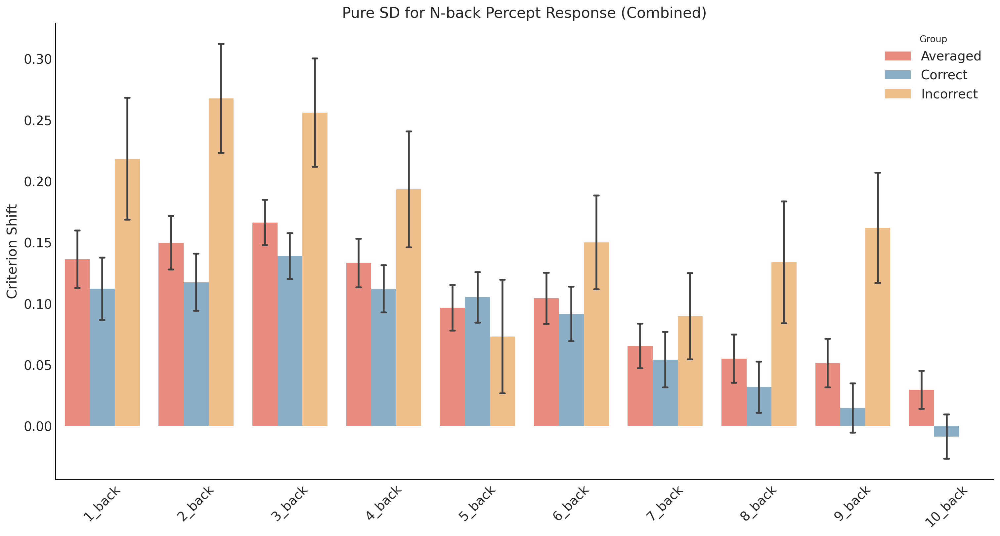

In [34]:
# Assuming the dataframes have similar structure and can be concatenated
# Creating two example dataframes with 23x10 dimension
df1 = SD_Percept_pure_cb
df2 = SD_Percept_Y_pure_cb
df3 = SD_Percept_N_pure_cb

# Adding an identifier column to distinguish between the two dataframes
df1['Group'] = 'Averaged'
df2['Group'] = 'Correct'
df3['Group'] = 'Incorrect'

# Concatenating the dataframes
df = pd.concat([df1, df2, df3])

# Melting the dataframe to a long format suitable for seaborn's barplot
df_long = df.melt(id_vars='Group', var_name='Column', value_name='Value')
SD_Percept_data = df_long

# Plotting the grouped bar chart
plt.figure(figsize=(15, 8))
sns.barplot(x='Column',
            y='Value',
            hue='Group',
            data=df_long,
            palette=[re, bl, ye],
            errorbar='se',
            errwidth=2,
            capsize=0.05)
plt.xticks(rotation=45)
plt.title('Pure SD for N-back Percept Response (Combined)')
plt.ylabel('Criterion Shift')
plt.xlabel('')
plt.show()

In [35]:
df_long_pivot = df_long.copy()
df_long_pivot['Subject'] = np.tile(np.arange(1, 33), 30)
df_long_pivot = df_long_pivot.pivot(index='Subject', columns=['Column', 'Group'])
df_long_pivot.columns = df_long_pivot.columns.droplevel(0)
df_long_pivot.columns = df_long_pivot.columns.map('{0[0]}_{0[1]}'.format)
df_long_pivot.to_csv('/Users/abel/Desktop/SD_analysis/SD_ALiyun/SD_output/csv/SD_Percept_data_cb.csv')


## 2.3 Pure Motor Serial Dependence

### 2.3.1 Averaged SD and Criterion

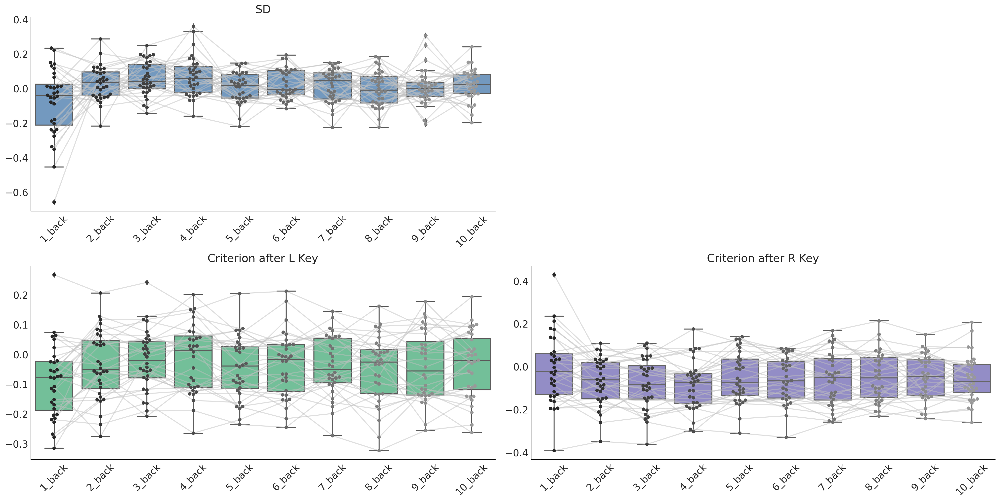

In [36]:
# Load data
with open('./SD_Motor_combined_averaged.pkl', 'rb') as f:
    [SD_Motor_cb, Criterion_Motor_L_cb,
     Criterion_Motor_R_cb] = dill.load(f)  # obj = dill.load(file)

SD_Motor_cb_pure = SD_Motor_cb - SD_Motor_Artifacts_cb

dt1 = SD_Motor_cb
dt2 = Criterion_Motor_L_cb
dt3 = Criterion_Motor_R_cb

plt.figure(figsize=(20, 10))
plt.subplot(2, 2, 1)
plt.title('SD')
sns.boxplot(data=dt1, color=grb)
sns.swarmplot(data=dt1, color=ak)
for i in range(32):
    plt.plot(np.arange(0, 10), dt1.iloc[i, :], color=sil, alpha=0.5)
plt.xticks(rotation=45)
plt.subplot(2, 2, 3)
plt.title('Criterion after L Key')
sns.boxplot(data=dt2, color=lig)
sns.swarmplot(data=dt2, color=ak)
for i in range(32):
    plt.plot(np.arange(0, 10), dt2.iloc[i, :], color=sil, alpha=0.5)
plt.xticks(rotation=45)
plt.subplot(2, 2, 4)
plt.title('Criterion after R Key')
sns.boxplot(data=dt3, color=vio)
sns.swarmplot(data=dt3, color=ak)
for i in range(32):
    plt.plot(np.arange(0, 10), dt3.iloc[i, :], color=sil, alpha=0.5)
plt.xticks(rotation=45)
plt.show()


### 2.3.2 Adding Feedback

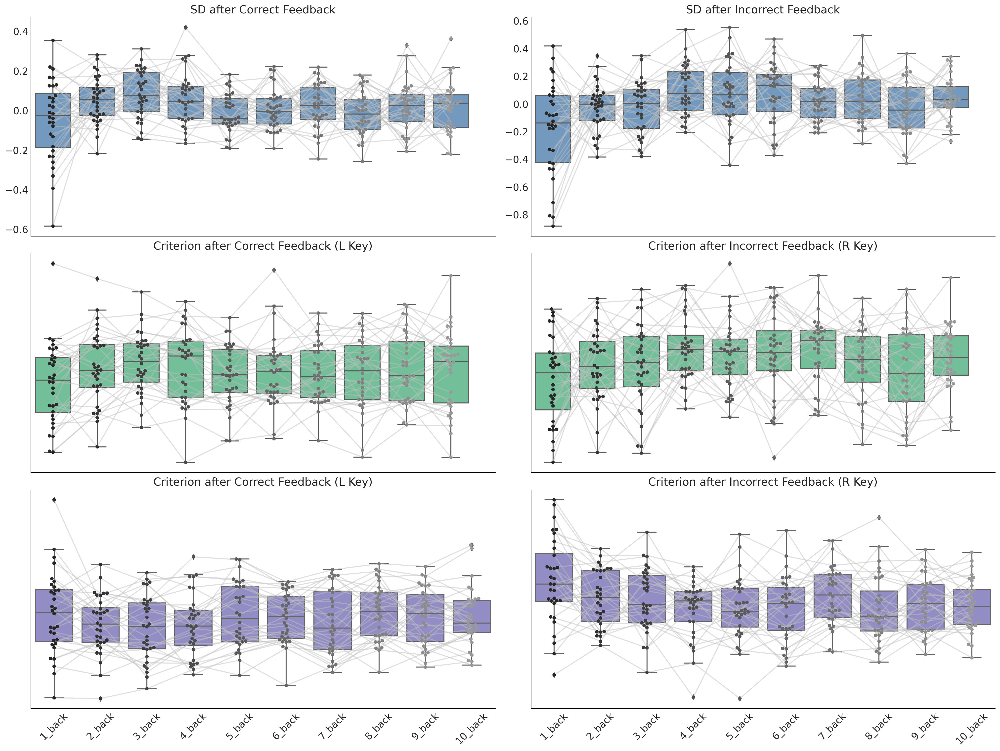

In [38]:
# load data
with open('./SD_Motor_combined_FB.pkl', 'rb') as f:
    [
        SD_Motor_Y_cb, Criterion_Motor_Y_L_cb, Criterion_Motor_Y_R_cb,
        SD_Motor_N_cb, Criterion_Motor_N_L_cb, Criterion_Motor_N_R_cb
    ] = dill.load(f)

SD_Motor_Y_cb_pure = SD_Motor_Y_cb - SD_Motor_Artifacts_cb
SD_Motor_N_cb_pure = SD_Motor_N_cb - SD_Motor_Artifacts_cb

df1 = SD_Motor_Y_cb
df2 = SD_Motor_N_cb
df3 = Criterion_Motor_Y_L_cb
df4 = Criterion_Motor_Y_R_cb
df5 = Criterion_Motor_N_L_cb
df6 = Criterion_Motor_N_R_cb

fig, axes = plt.subplots(3, 2, figsize=(20, 15), dpi=100)

axes[0, 0].set_title('SD after Correct Feedback')
sns.boxplot(data=df1, color=grb, ax=axes[0, 0])
sns.swarmplot(data=df1, color=ak, ax=axes[0, 0])
for i in range(32):
    axes[0, 0].plot(np.arange(0, 10),
                    df1.iloc[i, :],
                    color=sil,
                    alpha=0.5)
axes[0, 0].set_xticks('')
axes[0, 0].set_xticklabels('')
axes[0, 0].set_xlabel('')

axes[0, 1].set_title('SD after Incorrect Feedback')
sns.boxplot(data=df2, color=grb, ax=axes[0, 1])
sns.swarmplot(data=df2, color=ak, ax=axes[0, 1])
for i in range(32):
    axes[0, 1].plot(np.arange(0, 10),
                    df2.iloc[i, :],
                    color=sil,
                    alpha=0.5)
axes[0, 1].set_xticks('')
axes[0, 1].set_xticklabels('')
axes[0, 1].set_xlabel('')

axes[1, 0].set_title('Criterion after Correct Feedback (L Key)')
sns.boxplot(data=df3, color=lig, ax=axes[1, 0])
sns.swarmplot(data=df3, color=ak, ax=axes[1, 0])
for i in range(32):
    axes[1, 0].plot(np.arange(0, 10),
                    df3.iloc[i, :],
                    color=sil,
                    alpha=0.5)
axes[1, 0].set_xticks('')
axes[1, 0].set_xticklabels('')
axes[1, 0].set_xlabel('')
axes[1, 0].set_ylabel('')
axes[1, 0].set_yticklabels('')

axes[1, 1].set_title('Criterion after Incorrect Feedback (R Key)')
sns.boxplot(data=df5, color=lig, ax=axes[1, 1])
sns.swarmplot(data=df5, color=ak, ax=axes[1, 1])
for i in range(32):
    axes[1, 1].plot(np.arange(0, 10),
                    df5.iloc[i, :],
                    color=sil,
                    alpha=0.5)
axes[1, 1].set_xticks('')
axes[1, 1].set_xticklabels('')
axes[1, 1].set_xlabel('')
axes[1, 1].set_ylabel('')
axes[1, 1].set_yticklabels('')

axes[2, 0].set_title('Criterion after Correct Feedback (L Key)')
sns.boxplot(data=df4, color=vio, ax=axes[2, 0])
sns.swarmplot(data=df4, color=ak, ax=axes[2, 0])
for i in range(32):
    axes[2, 0].plot(np.arange(0, 10),
                    df4.iloc[i, :],
                    color=sil,
                    alpha=0.5)
axes[2, 0].set_xticklabels(labels=[
    '1_back', '2_back', '3_back', '4_back', '5_back', '6_back', '7_back',
    '8_back', '9_back', '10_back'
],
                           rotation=45)
axes[2, 0].set_yticklabels('')

axes[2, 1].set_title('Criterion after Incorrect Feedback (R Key)')
sns.boxplot(data=df6, color=vio, ax=axes[2, 1])
sns.swarmplot(data=df6, color=ak, ax=axes[2, 1])
for i in range(32):
    axes[2, 1].plot(np.arange(0, 10),
                    df6.iloc[i, :],
                    color=sil,
                    alpha=0.5)
plt.xticks(rotation=45)
axes[2, 1].set_yticklabels('')

plt.show()

### 2.3.3 Barplot

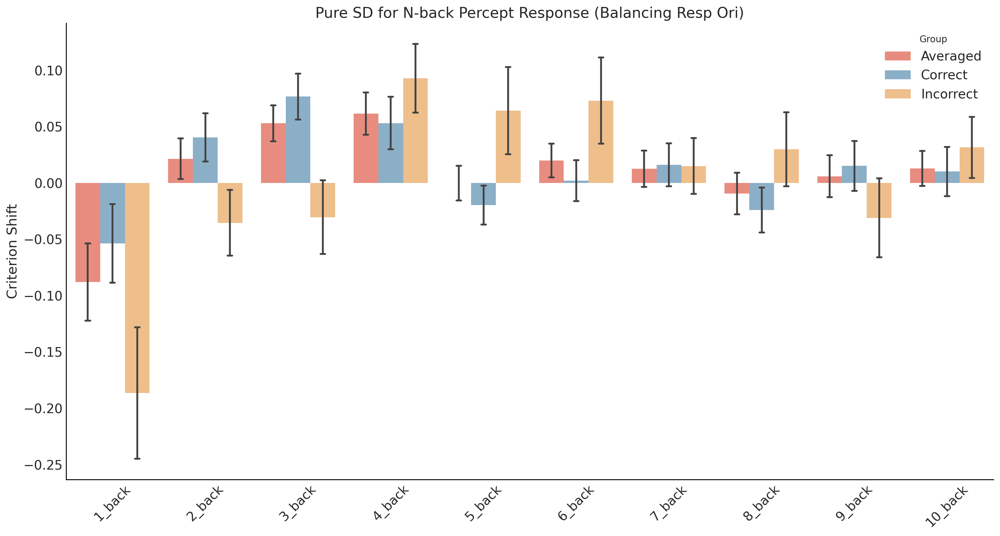

In [39]:
# Assuming the dataframes have similar structure and can be concatenated
# Creating two example dataframes with 23x10 dimension
df1 = SD_Motor_cb_pure
df2 = SD_Motor_Y_cb_pure
df3 = SD_Motor_N_cb_pure

# Adding an identifier column to distinguish between the two dataframes
df1['Group'] = 'Averaged'
df2['Group'] = 'Correct'
df3['Group'] = 'Incorrect'

# Concatenating the dataframes
df = pd.concat([df1, df2, df3])

# Melting the dataframe to a long format suitable for seaborn's barplot
df_long = df.melt(id_vars='Group', var_name='Column', value_name='Value')
SD_Percept_data = df_long

# Plotting the grouped bar chart
plt.figure(figsize=(15, 8))
sns.barplot(x='Column',
            y='Value',
            hue='Group',
            data=df_long,
            palette=[re, bl, ye],
            errorbar='se',
            errwidth=2,
            capsize=0.05)
plt.xticks(rotation=45)
plt.title('Pure SD for N-back Percept Response (Balancing Resp Ori)')
plt.ylabel('Criterion Shift')
plt.xlabel('')
plt.show()

In [40]:
df_long_pivot = df_long.copy()
df_long_pivot['Subject'] = np.tile(np.arange(1, 33), 30)
df_long_pivot = df_long_pivot.pivot(index='Subject', columns=['Column', 'Group'])
df_long_pivot.columns = df_long_pivot.columns.droplevel(0)
df_long_pivot.columns = df_long_pivot.columns.map('{0[0]}_{0[1]}'.format)
df_long_pivot.to_csv('/Users/abel/Desktop/SD_analysis/SD_ALiyun/SD_output/csv/SD_Motor_data_cb.csv')


# 3 Non-SDT Percentage Check

Due to limited data points when considering n-back and after wrong choice, a model-free approach is more suitable for calculating SD effects.

So here we chooose to measure SD-effect solely based on the proportion of choices of the target orientation.

which means:
    $$ \text{Bias}_{\text{percept}} = \text{ACC}_{45deg} - \frac{\text{ACC}_{45deg} + \text{ACC}_{-45deg}}{2} $$
    
equals to:
    $$ \text{Bias}_{\text{percept}} = \frac{\text{ACC}_{45deg} - \text{ACC}_{-45deg}}{2} $$
    
currently, positive bias means more 45deg choices, negative bias means more -45deg choices.

using the shift of Bias as the measure of SD effect, i.e.:
    $$ \text{SD}_{\text{percept}} = \text{Bias}_{\text{percept, nback = 45}} - \text{Bias}_{\text{percept, nack = -45}} $$

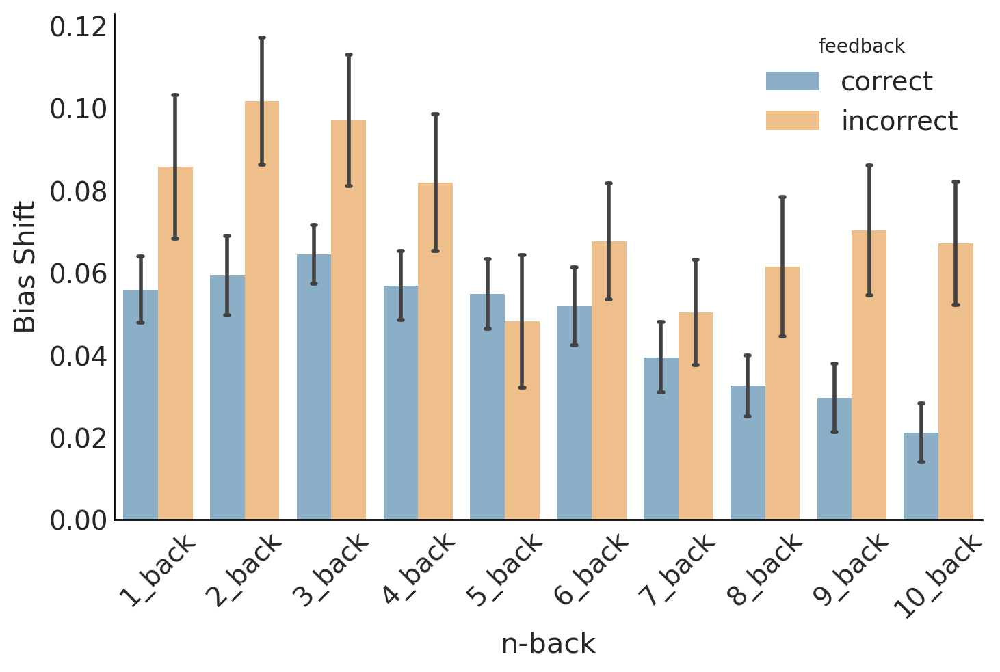

In [41]:
# load data
with open('./Bias_Shift_Perceptual.pkl', 'rb') as f:
    [
        Bias_shift_after_Y, Bias_shift_after_N, Bias_after_Y45,
        Bias_after_Yn45, Bias_after_N45, Bias_after_Nn45
    ] = dill.load(f)

df1 = Bias_shift_after_Y.copy()
df2 = Bias_shift_after_N.copy()
df1['feedback'] = 'correct'
df2['feedback'] = 'incorrect'
df = pd.concat([df1, df2])
df = df.melt(id_vars=['feedback'], var_name='n-back', value_name='Bias Shift')
sns.barplot(x='n-back',
            y='Bias Shift',
            hue='feedback',
            data=df,
            errorbar='se',
            palette=[bl, ye],
            errwidth=2,
            capsize=0.05)
plt.xticks(rotation=45)
plt.show()

In [42]:
df_long_pivot = df.copy()
df_long_pivot['Subject'] = np.tile(np.arange(1, 33), 20)
df_long_pivot = df_long_pivot.pivot(index='Subject', columns=['n-back', 'feedback'])
df_long_pivot.columns = df_long_pivot.columns.droplevel(0)
df_long_pivot.columns = df_long_pivot.columns.map('{0[0]}_{0[1]}'.format)
df_long_pivot.to_csv('/Users/abel/Desktop/SD_analysis/SD_ALiyun/SD_output/csv/Bias_shift_data.csv')


# 4 Confounder Check (Uncertainty)

## 4.1 Reaction Times

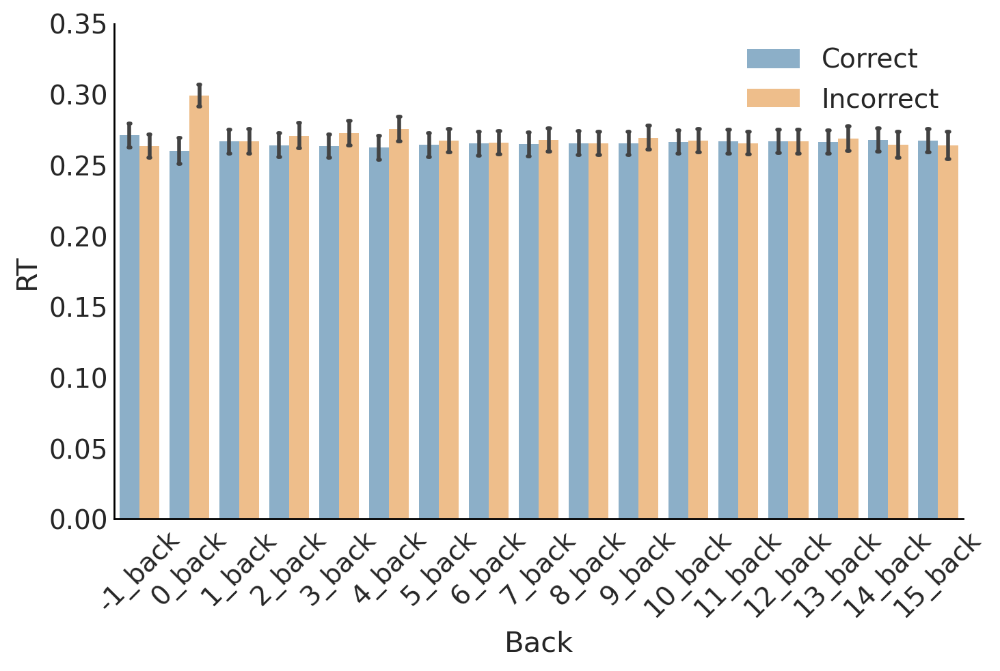

In [43]:
# load
with open('./RT_Check.pkl', 'rb') as f:
    RT_after_back = dill.load(f)
sns.barplot(x='Back',
            y='RT',
            hue='Prev_Accuracy',
            data=RT_after_back,
            errorbar='se',
            palette=[bl, ye],
            errwidth=2,
            capsize=0.05)
plt.ylim([0,0.35])
plt.legend(loc = 'upper right')
plt.xticks(rotation=45)
plt.show()

In [46]:
df_long_pivot = RT_after_back.copy()
df_long_pivot['Subject'] = np.tile(np.arange(1, 33), 34)
df_long_pivot = df_long_pivot.pivot(index='Subject', columns=['Back', 'Prev_Accuracy'])
df_long_pivot.columns = df_long_pivot.columns.droplevel(0)
df_long_pivot.columns = df_long_pivot.columns.map('{0[0]}_{0[1]}'.format)
df_long_pivot.to_csv('/Users/abel/Desktop/SD_analysis/SD_ALiyun/SD_output/csv/RT_data.csv')


## 4.2 Stimulus Contrast

<Figure size 1000x800 with 0 Axes>

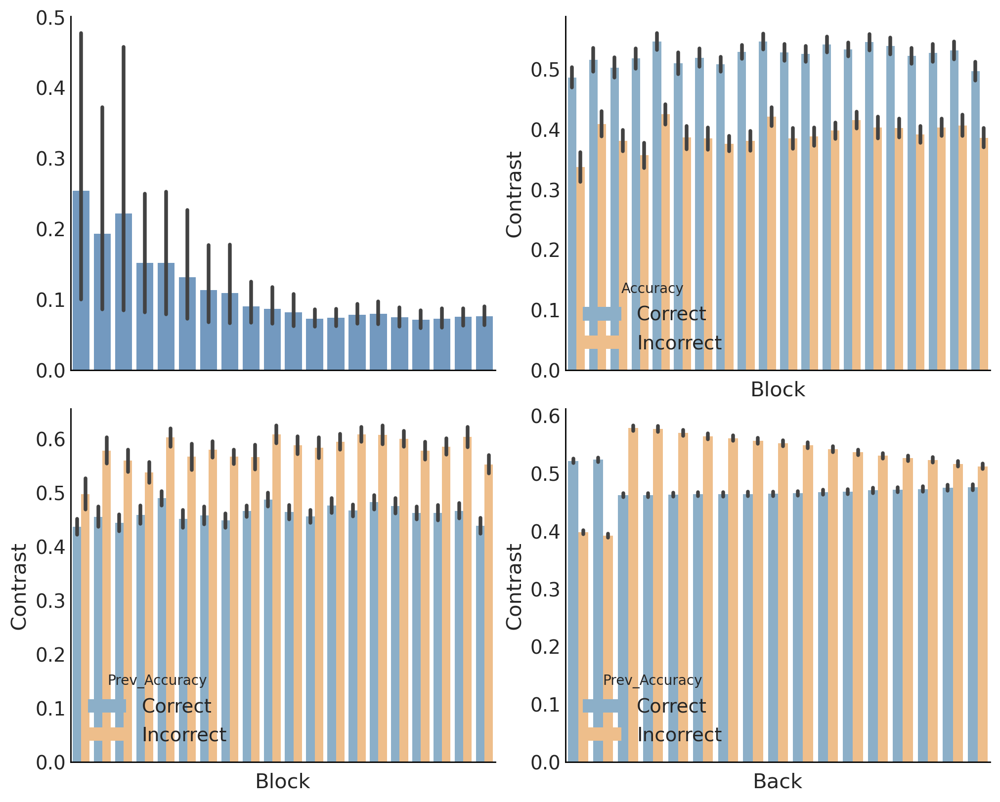

In [47]:
# Load data
with open('./Contrast_Check.pkl', 'rb') as f:
    [Averaged_Contrast, Contrasts_at, Contrast_after,
     Contrast_after_back] = dill.load(f)

plt.figure(figsize=(10, 8))
_, axes = plt.subplots(2, 2, figsize=(10, 8))
axes = axes.flatten()

sns.barplot(data=Averaged_Contrast, color=grb, ax=axes[0])
sns.barplot(x='Block',
            y='Contrast',
            hue='Accuracy',
            data=Contrasts_at,
            errorbar='se',
            palette=[bl, ye],
            ax=axes[1])
sns.barplot(x='Block',
            y='Contrast',
            hue='Prev_Accuracy',
            data=Contrast_after,
            errorbar='se',
            palette=[bl, ye],
            ax=axes[2]),
sns.barplot(x='Back',
            y='Contrast',
            hue='Prev_Accuracy',
            data=Contrast_after_back,
            errorbar='se',
            palette=[bl, ye],
            ax=axes[3])
for ax in axes:
    ax.set_xticklabels('')

plt.show()

In [48]:
df_long_pivot= Contrast_after_back.copy()
df_long_pivot['Subject'] = np.tile(np.arange(1, 33), 34)
df_long_pivot = df_long_pivot.pivot(index='Subject', columns=['Back', 'Prev_Accuracy'])
df_long_pivot.columns = df_long_pivot.columns.droplevel(0)
df_long_pivot.columns = df_long_pivot.columns.map('{0[0]}_{0[1]}'.format)
df_long_pivot.to_csv('/Users/abel/Desktop/SD_analysis/SD_ALiyun/SD_output/csv/Contrast_data.csv')
